<a href="https://colab.research.google.com/github/duchaba/Data-Augmentation-with-Python/blob/main/data_augmentation_with_python_chapter_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data Augmentation with Python, Chapter 3

# 🌻 Welcome to Chapter 3, "Image Augmentation for Classification"


In this chapter, we’ll cover the following topics: 

- Geometric transformations 

- Photometric transformations 

- Random  erasing 

- Combining augmentation techniques 

- Reinforce learning through Python code 

## Set up: Bring back Pluto

### ✋ STOP: Pull Method

- There are two methods to bring back Pluto.

1. Clone from GitHut (or update by doing "git pull if you have clone it before)

2. Or retrieve from an URL. The URL can be the GitHub URL or an URL the you store your Pluto python file from the first lesson.

- Do one, but not both.



### GitHub Clone

In [1]:
# git version should be 2.17.1 or higher
!git --version

git version 2.17.1


In [2]:
#url = 'https://github.com/PacktPublishing/Data-Augmentation-with-Python'
url = 'https://github.com/duchaba/Data-Augmentation-with-Python'
!git clone {url}

Cloning into 'Data-Augmentation-with-Python'...
remote: Enumerating objects: 127, done.
remote: Counting objects: 100% (52/52), done.
remote: Compressing objects: 100% (37/37), done.
remote: Total 127 (delta 19), reused 28 (delta 15), pack-reused 75
Receiving objects: 100% (127/127), 115.85 MiB | 15.06 MiB/s, done.
Resolving deltas: 100% (44/44), done.


### Fetch file from URL (Optional)

- Uncommend the below 2 code cells if you want to use URL and not Git Clone

In [3]:
# import requests
# #
# def fetch_file(url, dst):
#   downloaded_obj = requests.get(url)
#   with open(dst, "wb") as file:
#     file.write(downloaded_obj.content)
#   return

In [4]:
# url = ''
# dst = 'pluto_chapter_1.py'
# fetch_file(url,dst)

### Pluto

- Instantiate up Pluto, aka. "Pluto, wake up!"

In [5]:
#load and run the pluto chapter 1 Python code.
pluto_file = 'Data-Augmentation-with-Python/pluto/pluto_chapter_2.py'
%run {pluto_file}

---------------------------- : ----------------------------
            Hello from class : <class '__main__.PacktDataAug'> Class: PacktDataAug
                   Code name : Pluto
                   Author is : Duc Haba
---------------------------- : ----------------------------


- Double check on the server environments

In [6]:
pluto.say_sys_info()

---------------------------- : ----------------------------
                 System time : 2022/10/17 04:30
                    Platform : linux
       Python version (3.7+) : 3.7.14 (default, Sep  8 2022, 00:06:44) 
[GCC 7.5.0]
     PyTorch version (1.11+) : 1.12.1+cu113
     Pandas version (1.3.5+) : 1.3.5
        PIL version (9.0.0+) : 7.1.2
 Matplotlib version (3.2.2+) : 3.2.2
                   CPU count : 2
                  *CPU speed : NOT available
---------------------------- : ----------------------------


In [7]:
# !cat {pluto_file}

### ✋ STOP: Reinitalize Kaggle

- Install the following libraries, and import it on the Notebook.
- Follow by initialize Kaggle username, key and fetch methods.
- STOP: Update your Kaggle access username or key first.

In [8]:
# -------------------- : --------------------
# READ ME
# Chapter 2 begin:
# Install the following libraries, and import it on the Notebook.
# Follow by initialize Kaggle username, key and fetch methods.
# STOP: Update your Kaggle access username or key first.
# -------------------- : --------------------

!pip install opendatasets --upgrade
import opendatasets
print("\nrequired version 0.1.22 or higher: ", opendatasets.__version__)

!pip install pyspellchecker 
import spellchecker
print("\nRequired version 0.7+", spellchecker.__version__)

# STOP: Update your Kaggle access username or key first.
pluto.remember_kaggle_access_keys("duchaba", "0c737c90feacb5c56232b0d7c24e8664")
pluto._write_kaggle_credit()
import kaggle

@add_method(PacktDataAug)
def fetch_kaggle_comp_data(self,cname):
  #self._write_kaggle_credit()  # need to run only once.
  path = pathlib.Path(cname)
  kaggle.api.competition_download_cli(str(path))
  zipfile.ZipFile(f'{path}.zip').extractall(path)
  return

@add_method(PacktDataAug)
def fetch_kaggle_dataset(self,url,dest="kaggle"):
  #self._write_kaggle_credit()    # need to run only once.
  opendatasets.download(url,data_dir=dest)
  return
# -------------------- : --------------------


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

required version 0.1.22 or higher:  0.1.22
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.5 MB 14.9 MB/s 

Required version 0.7+ 0.7.0


# Fetch Kaggle Data

## Fetch and display Sea Animals

In [9]:
url = 'https://www.kaggle.com/datasets/vencerlanz09/sea-animals-image-dataste'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 266M/266M [00:03<00:00, 74.7MB/s]


In [10]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/sea-animals-image-dataste'
!find {f} -name "* *" -type d | rename 's/ /_/g'
#!find {f} -name "* *" -type f | rename 's/ /_/g'

In [11]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/sea-animals-image-dataste'
#!find {f} -name "* *" -type d | rename 's/ /_/g'
!find {f} -name "* *" -type f | rename 's/ /_/g'

In [12]:
# change method name to make_dir_dframe
pluto.df_sea_animal = pluto.build_shoe_fname(f)
pluto.df_sea_animal.head(3)

,fname,label
0,kaggle/sea-animals-image-dataste/Jelly_Fish/Je...,Jelly_Fish
1,kaggle/sea-animals-image-dataste/Jelly_Fish/16...,Jelly_Fish
2,kaggle/sea-animals-image-dataste/Jelly_Fish/68...,Jelly_Fish


In [13]:
# pluto.make_dir_dframe = lambda f: pluto.build_shoe_fname(f)
# df3 = pluto.make_dir_dframe('kaggle/sea-animals-image-dataste')
# df3.head()

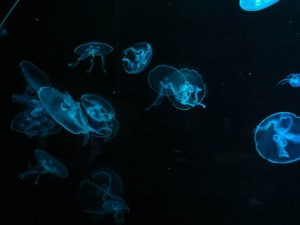

In [14]:
img = PIL.Image.open(pluto.df_sea_animal.fname[0])
display(img)

## covid 19

In [15]:
url = 'https://www.kaggle.com/datasets/pranavraikokte/covid19-image-dataset'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 158M/158M [00:02<00:00, 74.7MB/s]


In [16]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/covid19-image-dataset/Covid19-dataset/train'
!find {f} -name "* *" -type d | rename 's/ /_/g'
#!find {f} -name "* *" -type f | rename 's/ /_/g'

In [17]:
pluto.df_covid19 = pluto.build_shoe_fname(f)
pluto.df_covid19.head(3)


,fname,label
0,kaggle/covid19-image-dataset/Covid19-dataset/t...,Normal
1,kaggle/covid19-image-dataset/Covid19-dataset/t...,Normal
2,kaggle/covid19-image-dataset/Covid19-dataset/t...,Normal


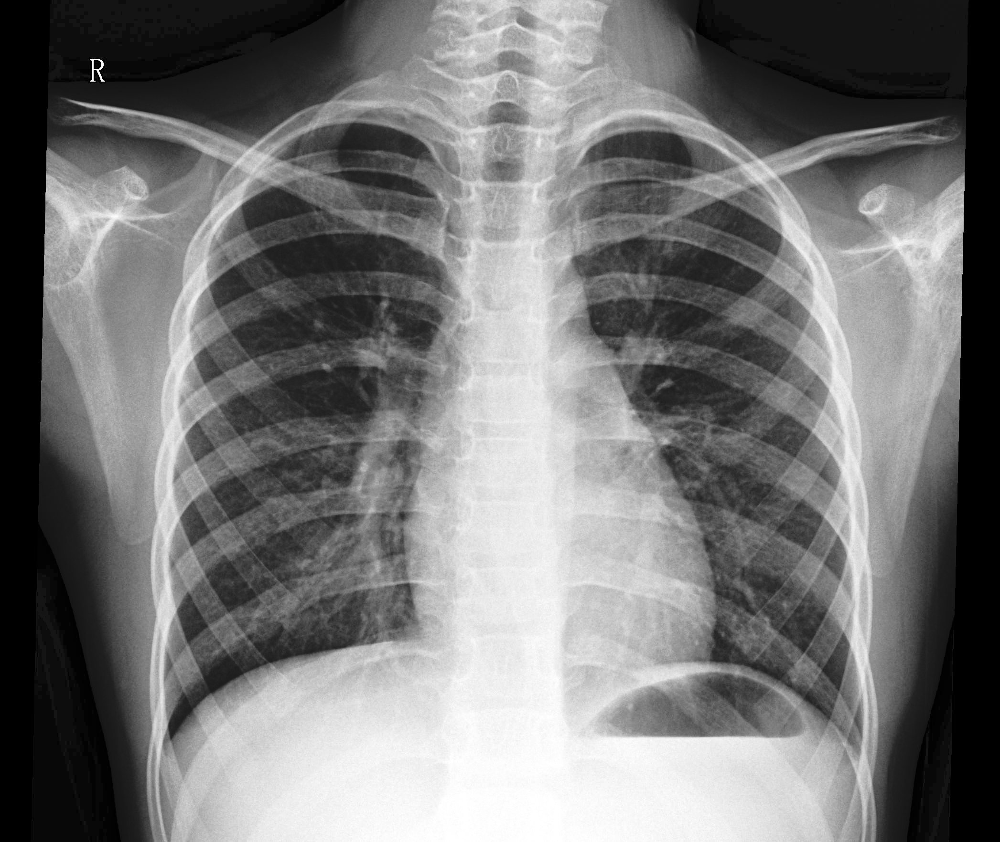

In [18]:
img = PIL.Image.open(pluto.df_covid19.fname[0])
display(img)

## Mall Crowd

In [19]:
url = 'https://www.kaggle.com/datasets/ferasoughali/mall-crowd-estimation'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 87.6M/87.6M [00:01<00:00, 48.9MB/s]


In [20]:
f = 'kaggle/mall-crowd-estimation/mall_dataset/frames/Thumbs.db'
!rm {f}

In [21]:
f = 'kaggle/mall-crowd-estimation/mall_dataset/frames'
pluto.df_crowd = pluto.build_shoe_fname(f)
pluto.df_crowd.head(3)

,fname,label
0,kaggle/mall-crowd-estimation/mall_dataset/fram...,frames
1,kaggle/mall-crowd-estimation/mall_dataset/fram...,frames
2,kaggle/mall-crowd-estimation/mall_dataset/fram...,frames


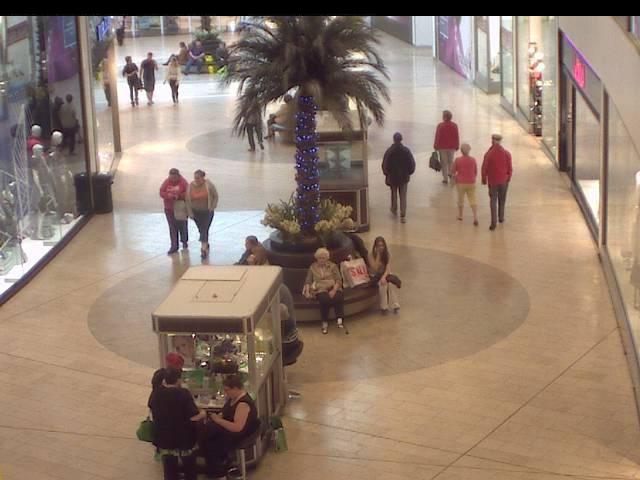

In [22]:
img = PIL.Image.open(pluto.df_crowd.fname[0])
display(img)

## Indian pictures

In [23]:
url = 'https://www.kaggle.com/datasets/sinhayush29/indian-people'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 228M/228M [00:03<00:00, 65.4MB/s]


In [24]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/indian-people'
!find {f} -name "* *" -type d | rename 's/ /_/g'
#!find {f} -name "* *" -type f | rename 's/ /_/g'

In [25]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/indian-people/Indian_Train_Set'
#!find {f} -name "* *" -type d | rename 's/ /_/g'
!find {f} -name "* *" -type f | rename 's/ /_/g'

In [26]:
f = 'kaggle/indian-people/Indian_Train_Set/Indian'
pluto.df_people = pluto.build_shoe_fname(f)
pluto.df_people.head(3)

,fname,label
0,kaggle/indian-people/Indian_Train_Set/Indian/T...,Indian
1,kaggle/indian-people/Indian_Train_Set/Indian/T...,Indian
2,kaggle/indian-people/Indian_Train_Set/Indian/T...,Indian


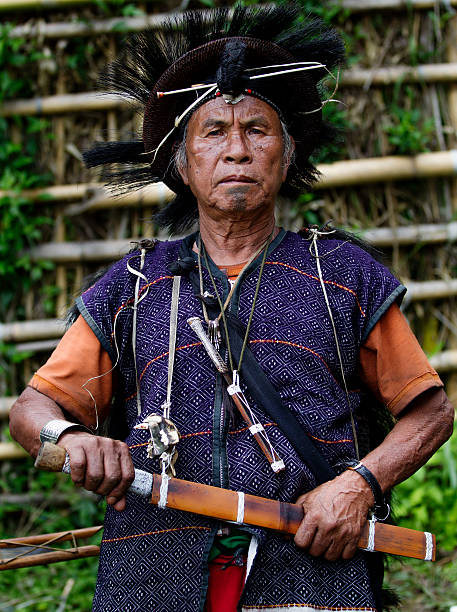

In [27]:
img = PIL.Image.open(pluto.df_people.fname[0])
display(img)

## Vietnamese food

In [28]:
url = 'https://www.kaggle.com/datasets/quandang/vietnamese-foods'
pluto.fetch_kaggle_dataset(url)
# use word assemble

100%|██████████| 4.17G/4.17G [01:03<00:00, 70.7MB/s]


In [29]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/vietnamese-foods/Images/Train'
!find {f} -name "* *" -type d | rename 's/ /_/g'
#!find {f} -name "* *" -type f | rename 's/ /_/g'

In [30]:
f = 'kaggle/vietnamese-foods/Images/Train'
pluto.df_food = pluto.build_shoe_fname(f)
pluto.df_food.head(3)

,fname,label
0,kaggle/vietnamese-foods/Images/Train/Xoi_xeo/2...,Xoi_xeo
1,kaggle/vietnamese-foods/Images/Train/Xoi_xeo/4...,Xoi_xeo
2,kaggle/vietnamese-foods/Images/Train/Xoi_xeo/5...,Xoi_xeo


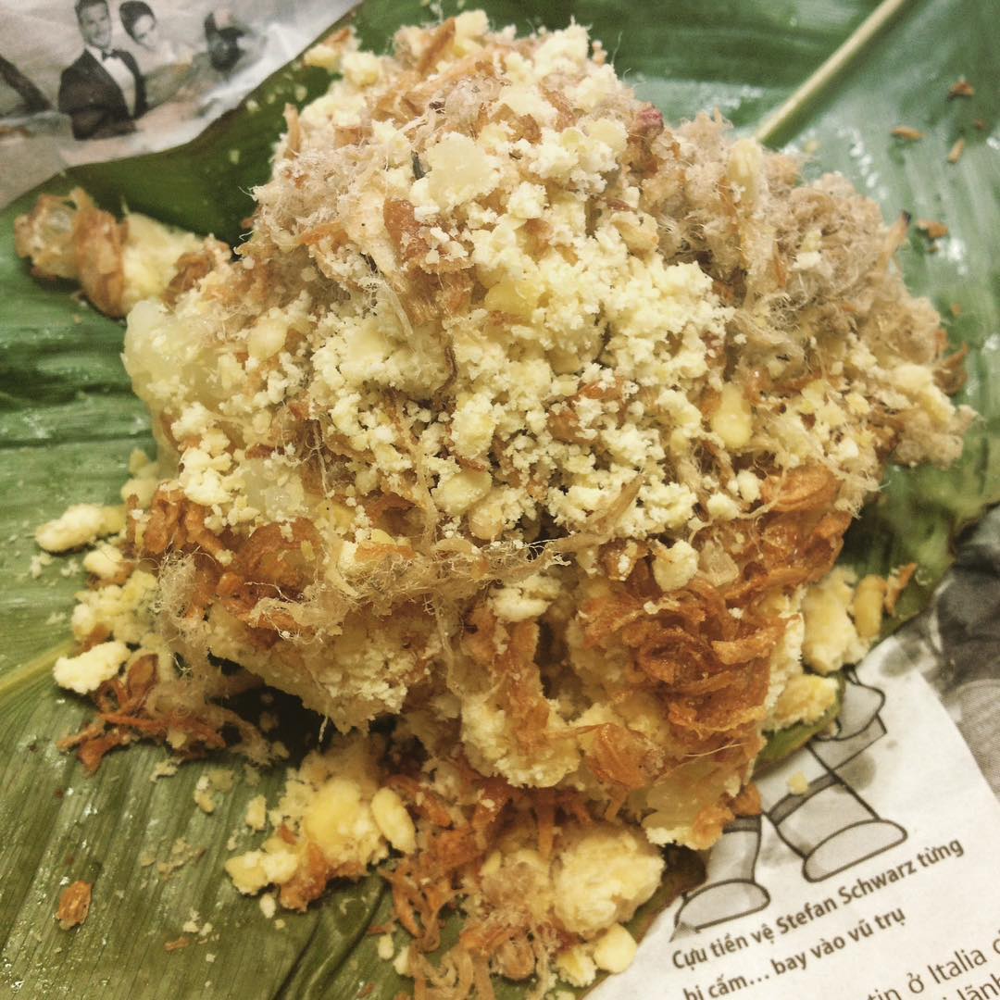

In [31]:
img = PIL.Image.open(pluto.df_food.fname[0])
display(img)

## Fungi

In [32]:
url = 'https://www.kaggle.com/datasets/marcosvolpato/edible-and-poisonous-fungi'
pluto.fetch_kaggle_dataset(url)
# use word assemble

100%|██████████| 257M/257M [00:04<00:00, 58.5MB/s]


In [33]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/edible-and-poisonous-fungi'
!find {f} -name "* *" -type d | rename 's/ /_/g'
#!find {f} -name "* *" -type f | rename 's/ /_/g'

In [34]:
# remove white space in directory and filename
# run this until no error/output
f = 'kaggle/edible-and-poisonous-fungi'
# !find {f} -name "* *" -type d | rename 's/ /_/g'
!find {f} -name "* *" -type f | rename 's/ /_/g'

In [35]:
pluto.df_fungi = pluto.build_shoe_fname(f)
pluto.df_fungi.head(3)

,fname,label
0,kaggle/edible-and-poisonous-fungi/poisonous_sp...,poisonous_sporocarp
1,kaggle/edible-and-poisonous-fungi/poisonous_sp...,poisonous_sporocarp
2,kaggle/edible-and-poisonous-fungi/poisonous_sp...,poisonous_sporocarp


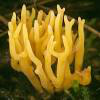

In [36]:
img = PIL.Image.open(pluto.df_fungi.fname[0])
display(img)

# Draw the Images

## display patch

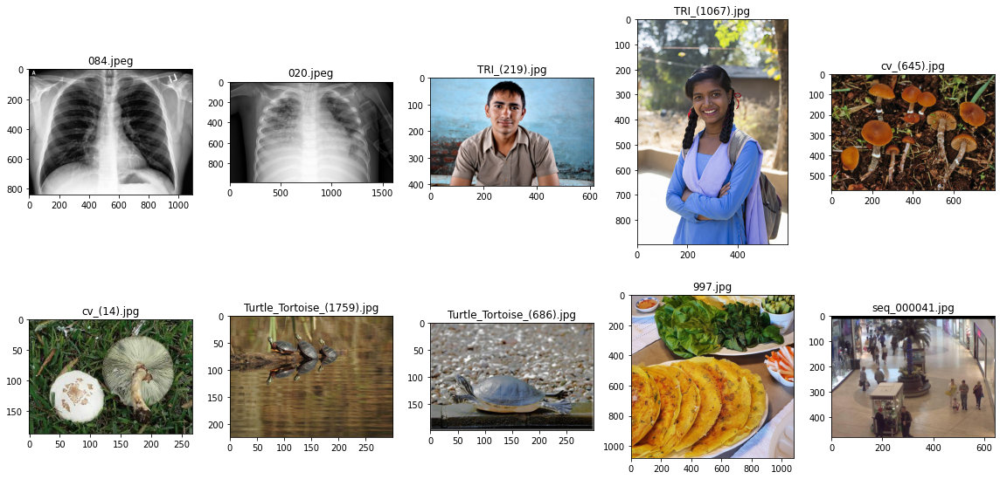

In [37]:
df = [pluto.df_covid19.sample(2), pluto.df_people.sample(2),
  pluto.df_fungi.sample(2), pluto.df_sea_animal.sample(2),
  pluto.df_food.sample(1), pluto.df_crowd.sample(1)]

df_samp = pandas.concat(df)
x = pluto.draw_batch(df_samp.fname)

# Geometric transformations filters 

In [38]:
!pip install -Uqq fastai
from fastcore.all import *
import fastai
import fastai.vision
import fastai.vision.core
import fastai.vision.augment
import numpy
print("\nfastai version (should be 2.6.3 or higher): ", fastai.__version__)


fastai version (should be 2.6.3 or higher):  2.7.9


## Horizontal flip

In [39]:
import PIL
import PIL.ImageOps
@add_method(PacktDataAug)
def draw_image_flip_pil(self,fname):
  img = PIL.Image.open(fname)
  mirror_img = PIL.ImageOps.mirror(img)
  display(img, mirror_img)
  return

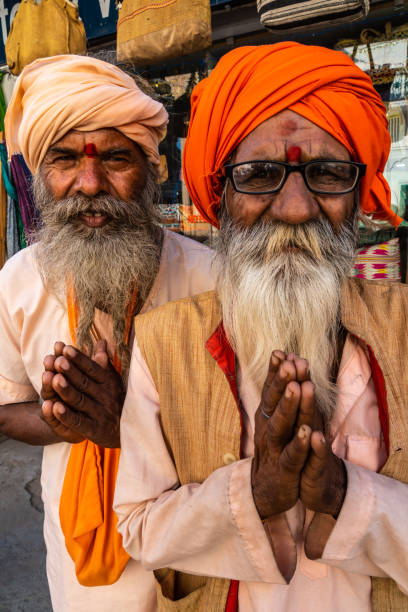

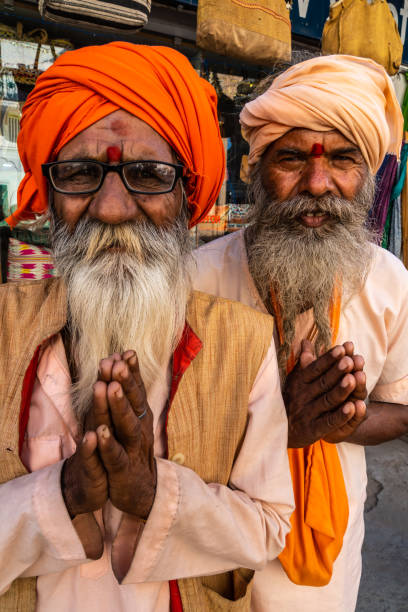

In [40]:
pluto.draw_image_flip_pil(pluto.df_people.fname[100])

In [41]:
# import fastai.vision.augment.CropPad??

In [42]:
@add_method(PacktDataAug)
def _make_data_loader(self,df, tfms, i_tfms=None):
  dls = fastai.vision.data.ImageDataLoaders.from_df(df, 
  fn_col="fname",label_col="label",
  item_tfms=i_tfms,
  batch_tfms=tfms,
  valid_pct=0.2,
  bs=32)
  return dls
#
# fastai.vision.augment.RandomCrop
# fastai.vision.augment.CropPad(480)
# import fastai.vision.augment. (to see all other option like flip, hue, etc)
@add_method(PacktDataAug)
def draw_image_flip(self,df,bsize=15):
  aug = [fastai.vision.augment.Flip(p=0.8)]
  itfms = fastai.vision.augment.Resize(480)
  dsl_org = self._make_data_loader(df, aug,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

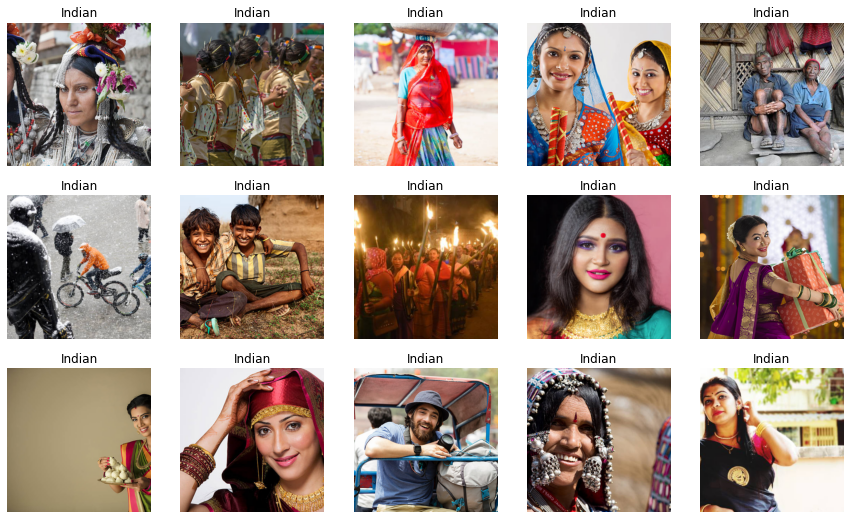

In [43]:
pluto.dls_people = pluto.draw_image_flip(pluto.df_people)

In [44]:
# augmentations = [
#         Rotate(10, p=0.4, mode='bilinear'), 
#         Brightness(max_lighting=0.3,p=0.5),
#         Contrast(max_lighting=0.4, p=0.5),
#         RandomErasing(p=0.3, sl=0.0, sh=0.2, min_aspect=0.3, max_count=1),
#         Flip(p=0.5),
#         Zoom(max_zoom=1,p=0.5),
#         RandomResizedCrop(img_size)
#     ]

In [45]:
# @add_method(PacktDataAug)
# def draw_image_rotate(self,df,bsize=15):
#   aug = [fastai.vision.augment.Rotate(90,p=0.75,pad_mode='zeros')]
#   itfms = fastai.vision.augment.Resize(480)
#   dsl_org = self._make_data_loader(df, aug,itfms)
#   dsl_org.show_batch(max_n=bsize)
#   return dsl_org

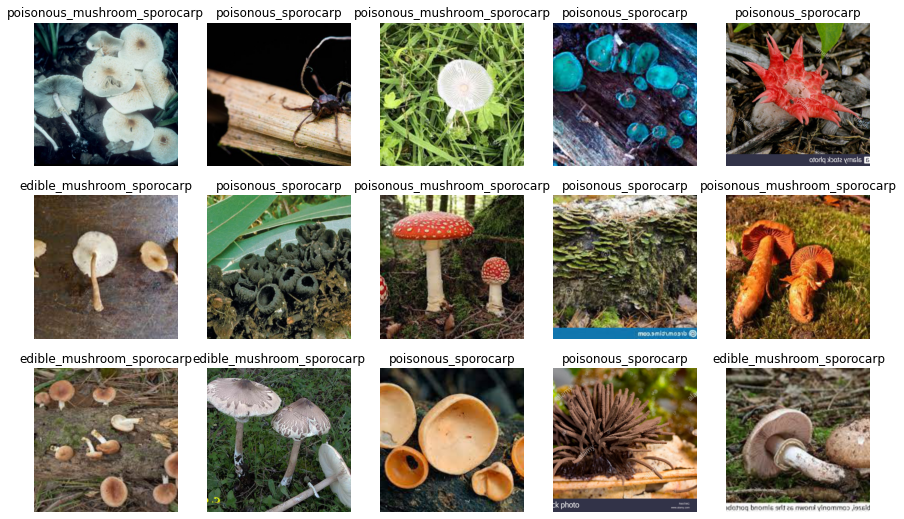

In [46]:
pluto.dls_fungi = pluto.draw_image_flip(pluto.df_fungi)

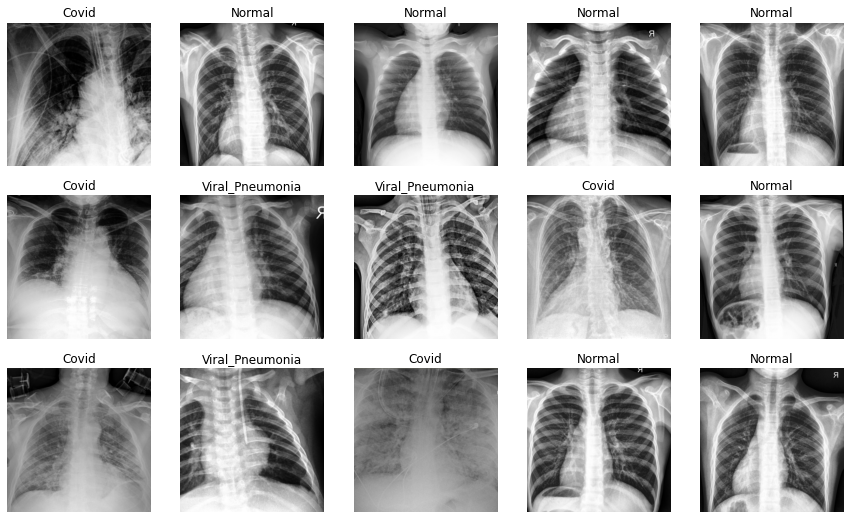

In [47]:
pluto.dls_covid19 = pluto.draw_image_flip(pluto.df_covid19)

In [48]:
@add_method(PacktDataAug)
def draw_image_flip_both(self,df,bsize=15,pad_mode='zeros'):
  aug = fastai.vision.augment.Dihedral(p=0.8,pad_mode=pad_mode)
  itfms = fastai.vision.augment.Resize(480)
  dsl_org = self._make_data_loader(df, aug,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

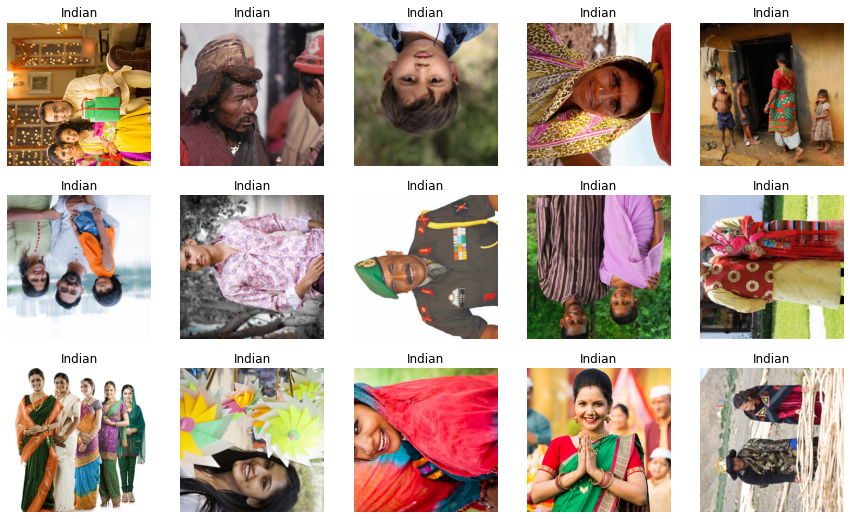

In [49]:
pluto.dls_people = pluto.draw_image_flip_both(pluto.df_people,pad_mode='reflection')

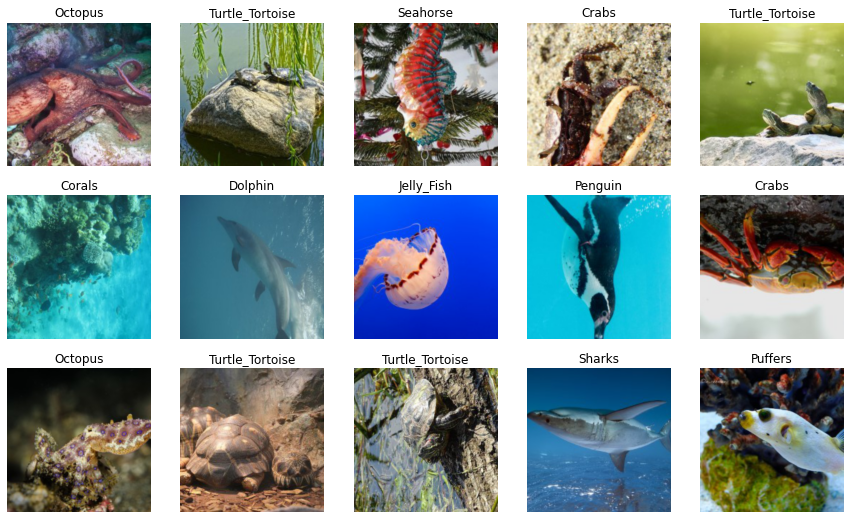

In [50]:
pluto.dls_sea_animal = pluto.draw_image_flip_both(pluto.df_sea_animal,pad_mode='border')

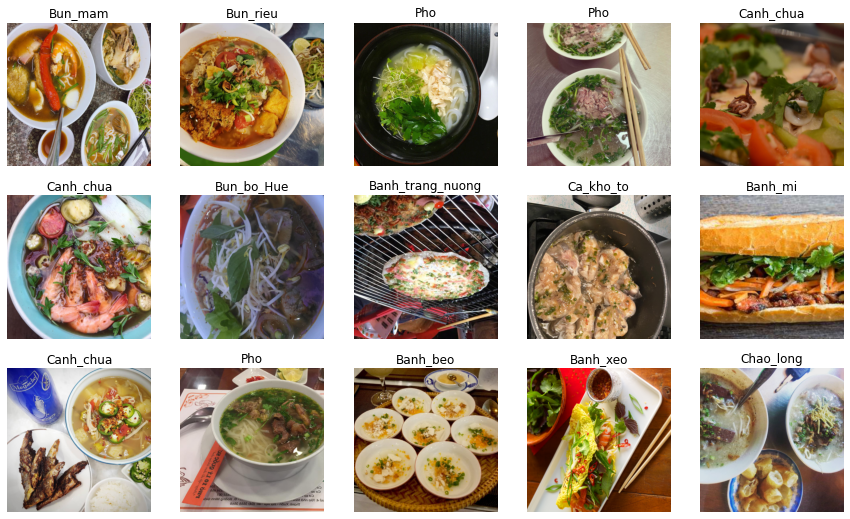

In [51]:
pluto.dls_food = pluto.draw_image_flip_both(pluto.df_food,pad_mode='reflection')

## Croping and Padding

In [52]:
@add_method(PacktDataAug)
def draw_image_crop(self,df,bsize=15,pad_mode="zeros",isize=480):
  aug = fastai.vision.augment.CropPad(isize,pad_mode=pad_mode)
  itfms = fastai.vision.augment.CropPad(isize, pad_mode=pad_mode)
  dsl_org = self._make_data_loader(df, aug,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

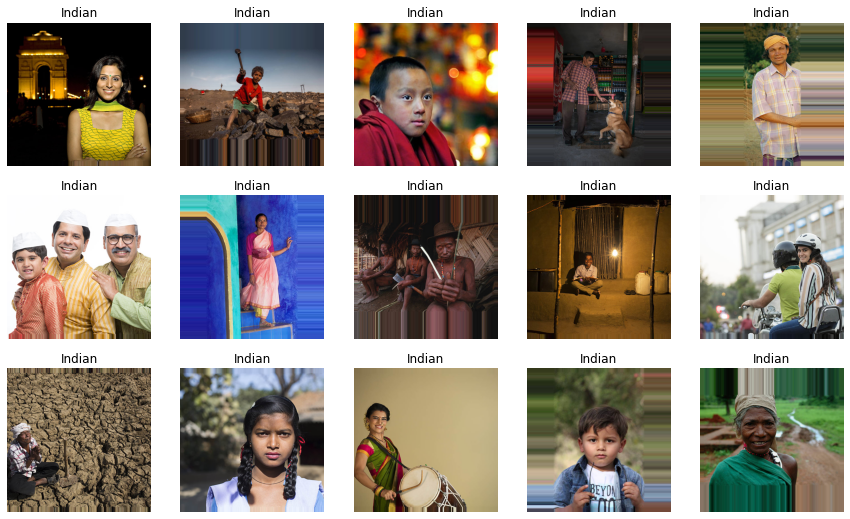

In [53]:
pluto.dls_people = pluto.draw_image_crop(pluto.df_people, pad_mode="border",isize=640)

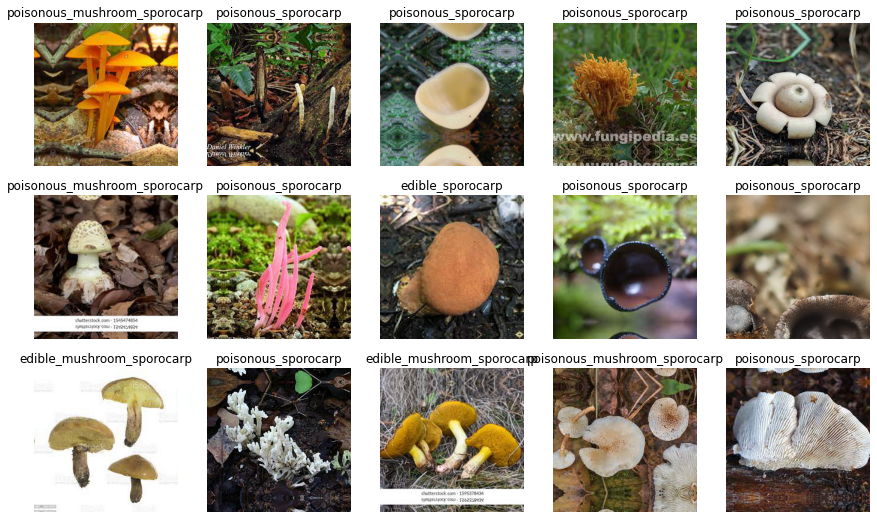

In [54]:
pluto.dls_fungi = pluto.draw_image_crop(pluto.df_fungi,pad_mode="reflection",isize=240)

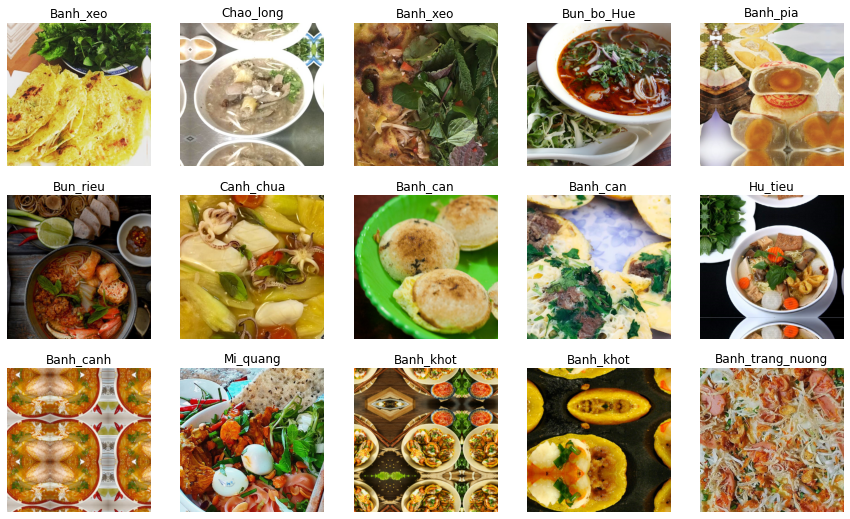

In [55]:
pluto.dls_food = pluto.draw_image_crop(pluto.df_food,pad_mode="reflection",isize=640)

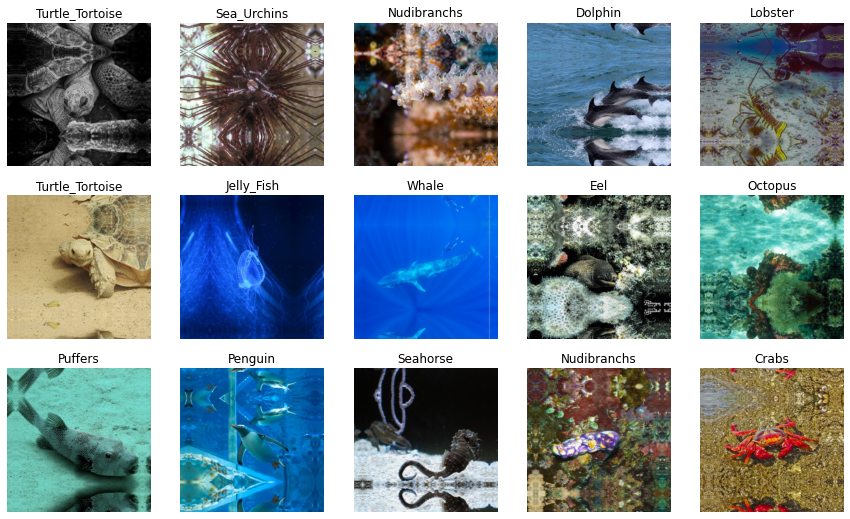

In [56]:
pluto.dls_sea_animal = pluto.draw_image_crop(pluto.df_sea_animal,pad_mode="reflection", isize=340)

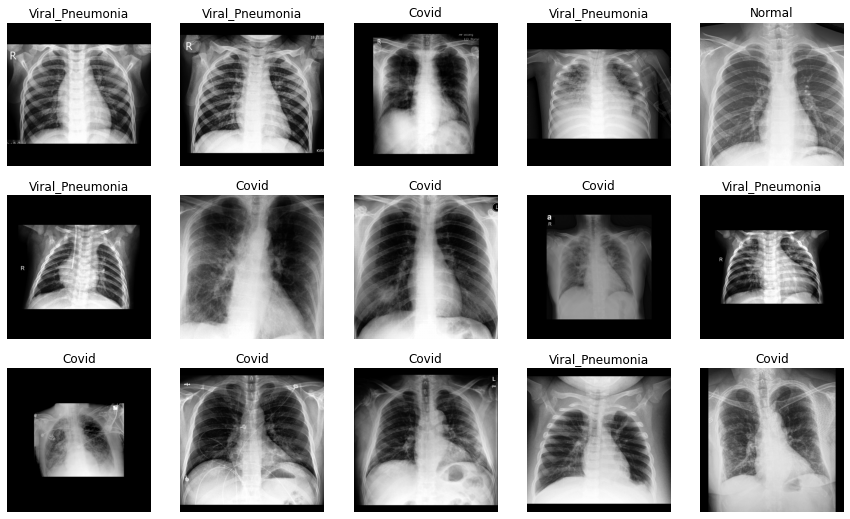

In [57]:
pluto.dls_covid19 = pluto.draw_image_crop(pluto.df_covid19,pad_mode="zeros", isize=1600)

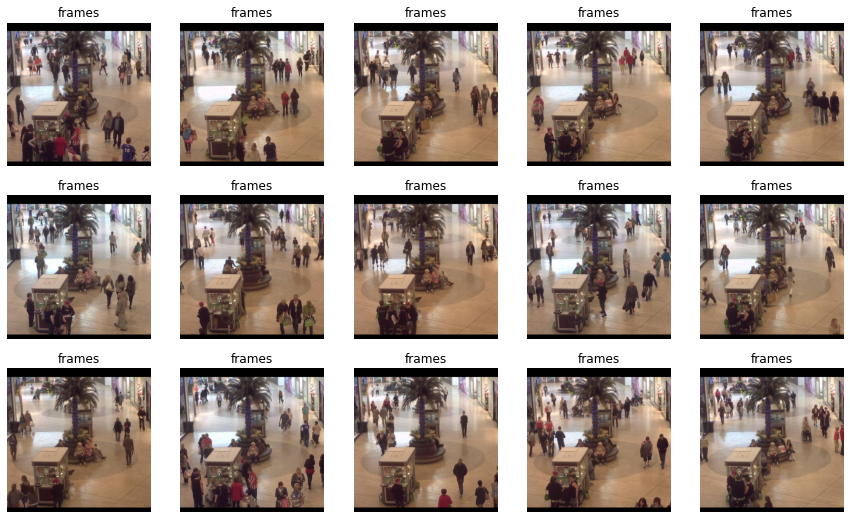

In [58]:
pluto.dls_crowd = pluto.draw_image_crop(pluto.df_crowd,pad_mode="zeros", isize=512)

## Rotation

In [59]:
@add_method(PacktDataAug)
def draw_image_rotate(self,df,bsize=15,max_rotate=45.0,pad_mode='zeros'):
  aug = [fastai.vision.augment.Rotate(max_rotate,p=0.75,pad_mode=pad_mode)]
  itfms = fastai.vision.augment.Resize(480)
  dsl_org = self._make_data_loader(df, aug,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

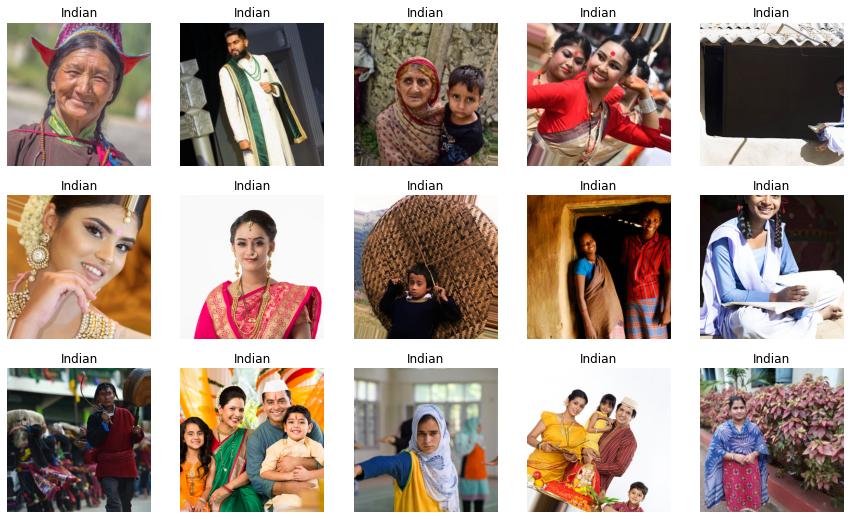

In [60]:
pluto.dls_people = pluto.draw_image_rotate(pluto.df_people,max_rotate=25.0, pad_mode='border')

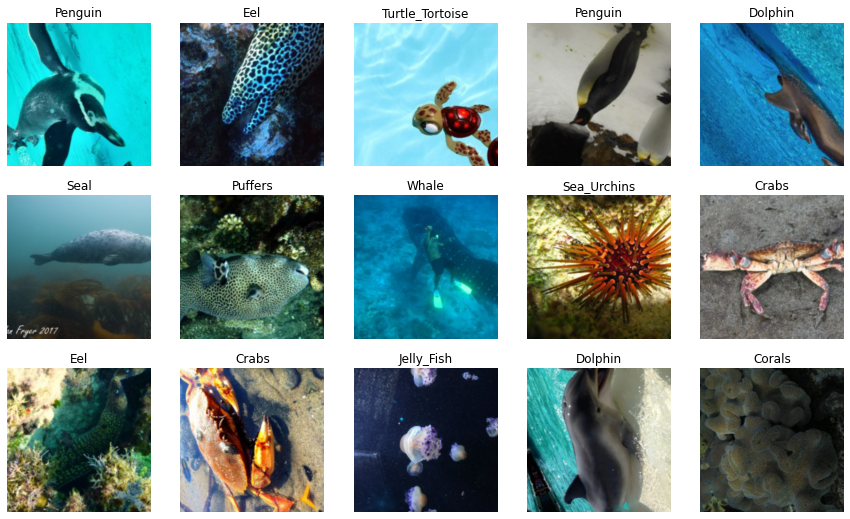

In [61]:
pluto.dls_sea_animal = pluto.draw_image_rotate(pluto.df_sea_animal,max_rotate=180.0, pad_mode='reflection')

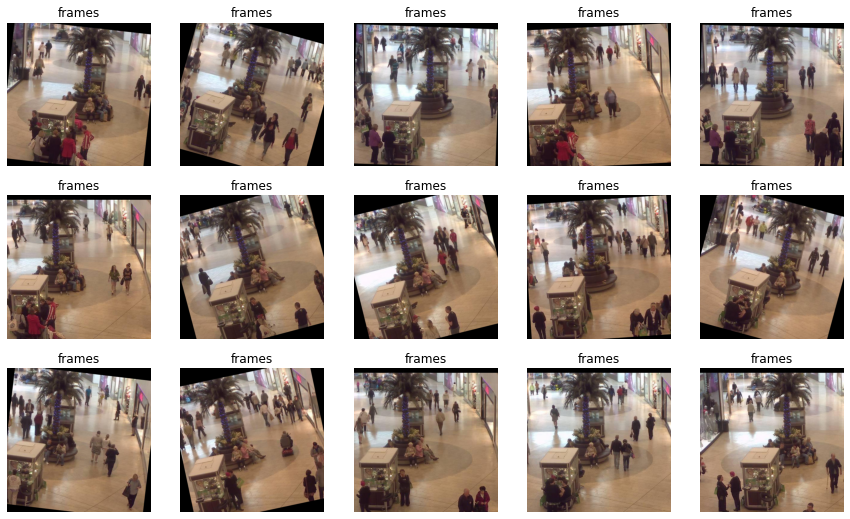

In [62]:
pluto.dls_crowd = pluto.draw_image_rotate(pluto.df_crowd,max_rotate=16.0, pad_mode='zeros')

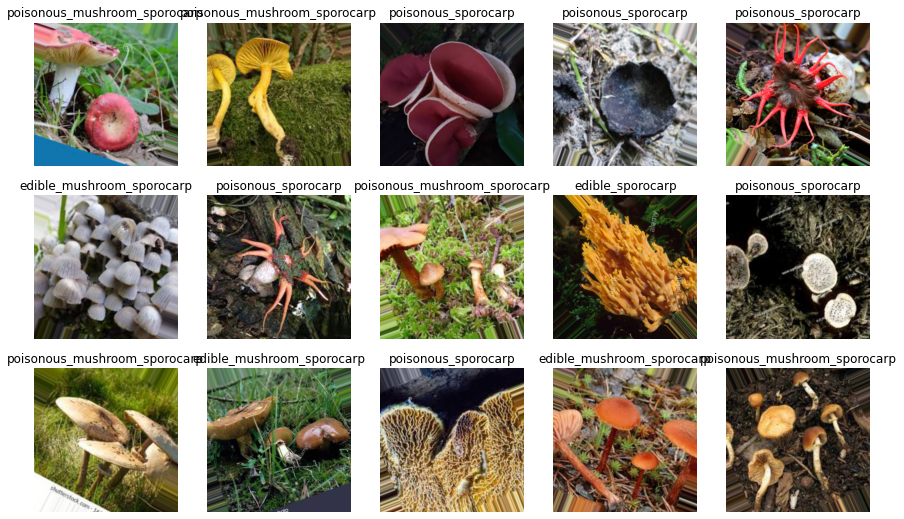

In [63]:
pluto.dls_fungi = pluto.draw_image_rotate(pluto.df_fungi,max_rotate=45.0, pad_mode='border')

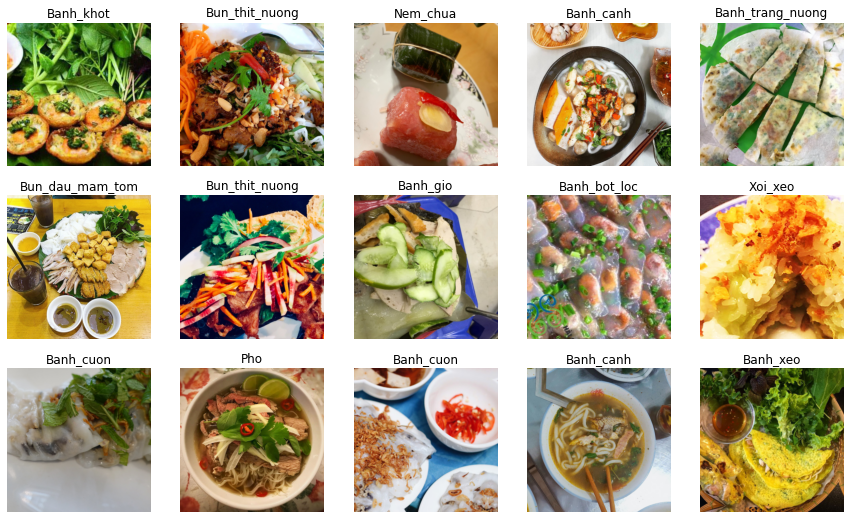

In [64]:
pluto.dls_food = pluto.draw_image_rotate(pluto.df_food,max_rotate=90.0, pad_mode='reflection')

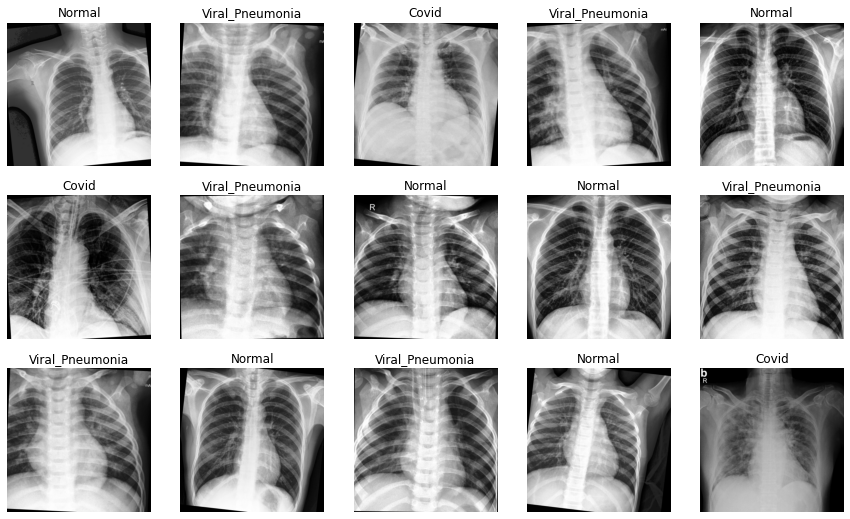

In [65]:
pluto.dls_covid19 = pluto.draw_image_rotate(pluto.df_covid19,max_rotate=8.0, pad_mode='zeros')

In [66]:
#fastai.vision.augment.cutout_gaussian?

## Warping

In [67]:
@add_method(PacktDataAug)
def draw_image_warp(self,df,bsize=15,magnitude=0.2,pad_mode='zeros'):
  aug = [fastai.vision.augment.Warp(magnitude=magnitude, pad_mode=pad_mode,p=0.75)]
  itfms = fastai.vision.augment.Resize(480)
  dsl_org = self._make_data_loader(df, aug,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

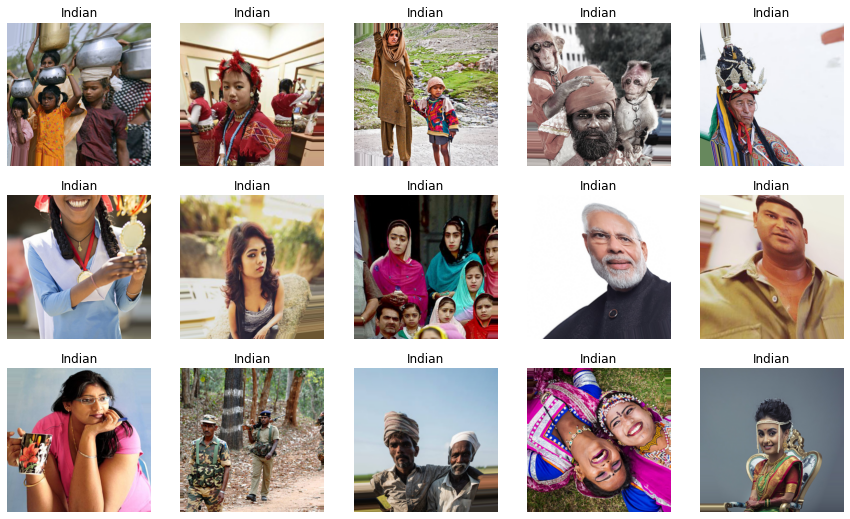

In [68]:
pluto.dls_people = pluto.draw_image_warp(pluto.df_people,magnitude=0.4,pad_mode='border')

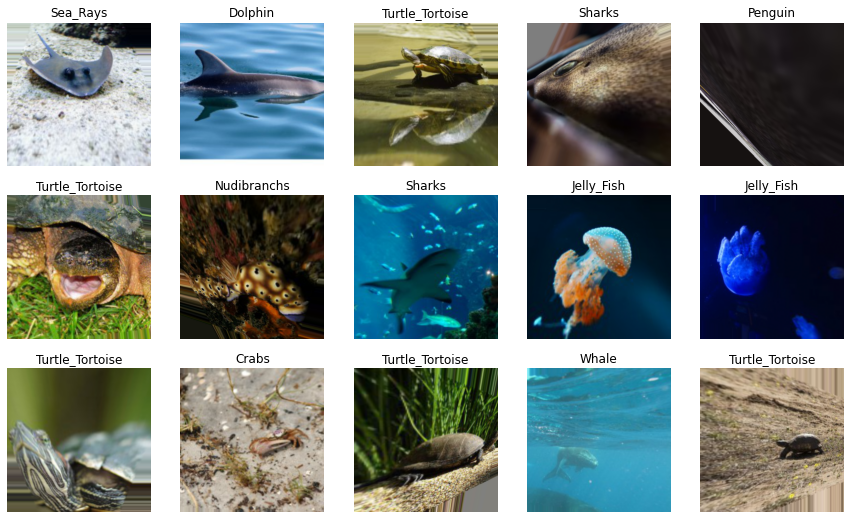

In [69]:
pluto.dls_sea_animal = pluto.draw_image_warp(pluto.df_sea_animal,magnitude=0.5,pad_mode='border')

## Translation

In [70]:
@add_method(PacktDataAug)
def draw_image_shift_pil(self,fname, x_axis, y_axis=0):
  img = PIL.Image.open(fname)
  shift_img = PIL.ImageChops.offset(img,x_axis,y_axis)
  display(img, shift_img)
  return

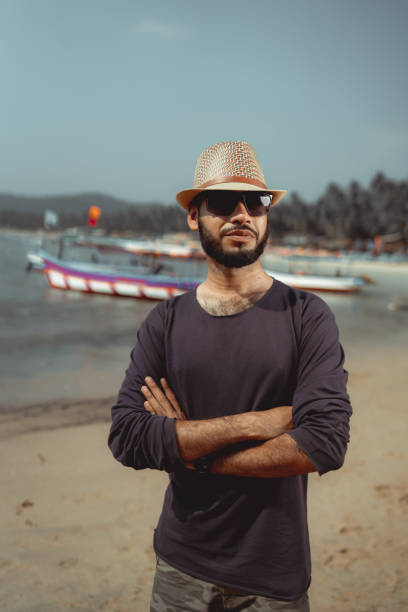

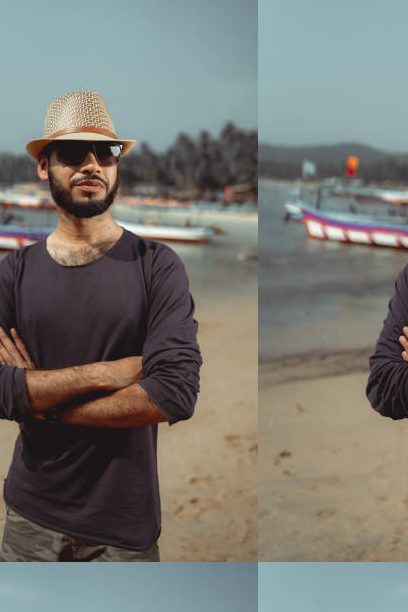

In [71]:
f = pluto.df_people.fname[30]
pluto.draw_image_shift_pil(f, -150, -50)

# Phometric transformations

In [72]:
#!pip install albumentations

In [73]:
try:
  pluto._ph()
  import albumentations
  pluto._pp("albumentations 1.2.1", "actual " + albumentations.__version__)
# import cat2
except ImportError as e:
  pluto._ph()
  pluto._pp("**Error", e)
pluto._ph()

---------------------------- : ----------------------------
        albumentations 1.2.1 : actual 1.2.1
---------------------------- : ----------------------------


In [74]:
@add_method(PacktDataAug)
def _draw_image_album(self,df,aug_album,bsize=5):
  if (bsize == 2):
    ncol = 2
    nrow = 1
    w = 16
    h = 8
  else:
    ncol = 5
    nrow = int(numpy.ceil(bsize/ncol))
    w = 14
    h = int(4 * nrow)
  #
  canvas, pic = matplotlib.pyplot.subplots(nrow, ncol, figsize=(w, h))
  pics = pic.flatten()
  # select random images
  samp = df.sample(int(ncol * nrow))
  samp.reset_index(drop=True, inplace=True)
  for i, ax in enumerate(pics):
    # convert to an array
    img_numpy = numpy.array(PIL.Image.open(samp.fname[i]))
    label = df.label[i]
    # perform the transformation using albumentations
    img = aug_album(image=img_numpy)['image']
    # display the image in batch modde
    ax.imshow(img)
    ax.set_title(label)
  canvas.tight_layout()
  canvas.show()
  return

## Lighting

In [75]:
@add_method(PacktDataAug)
def draw_image_brightness(self,df,brightness=0.2,bsize=5):
  aug_album = albumentations.ColorJitter(brightness=brightness,
    contrast=0.0, saturation=0.0,hue=0.0,always_apply=True, p=1.0)
  self._draw_image_album(df,aug_album,bsize)
  return

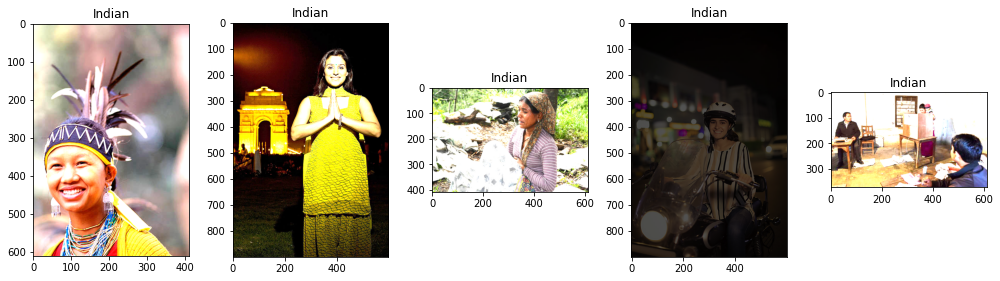

In [76]:
pluto.draw_image_brightness(pluto.df_people, brightness = 1.7)

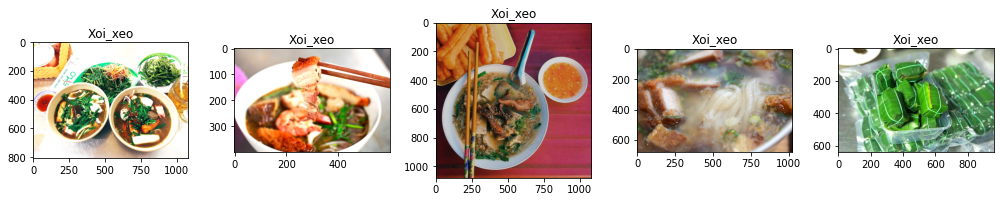

In [77]:
pluto.draw_image_brightness(pluto.df_food, brightness=0.3)

## Grayscale


In [78]:
@add_method(PacktDataAug)
def draw_image_grayscale(self,df,bsize=5):
  aug_album = albumentations.ToGray(p=1.0)
  self._draw_image_album(df,aug_album,bsize)
  return

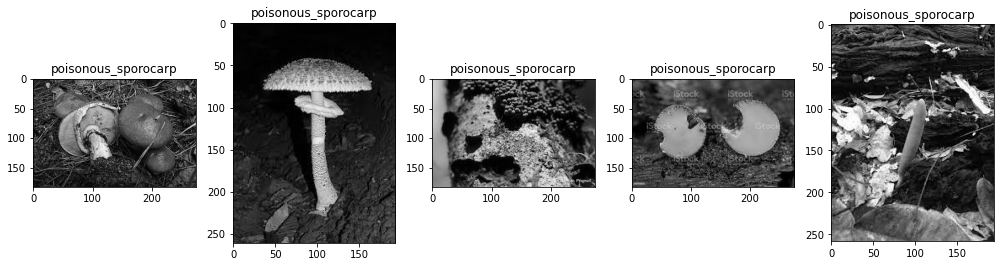

In [79]:
pluto.draw_image_grayscale(pluto.df_fungi)

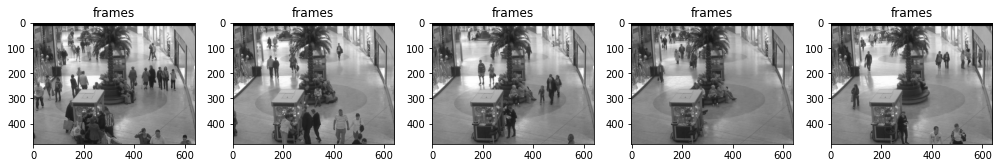

In [80]:
pluto.draw_image_grayscale(pluto.df_crowd)

## Contrast

In [81]:
@add_method(PacktDataAug)
def draw_image_contrast(self,df,contrast=0.2,bsize=5):
  aug_album = albumentations.ColorJitter(brightness=0.0,
    contrast=contrast, saturation=0.0,hue=0.0,always_apply=True, p=1.0)
  self._draw_image_album(df,aug_album,bsize)
  return

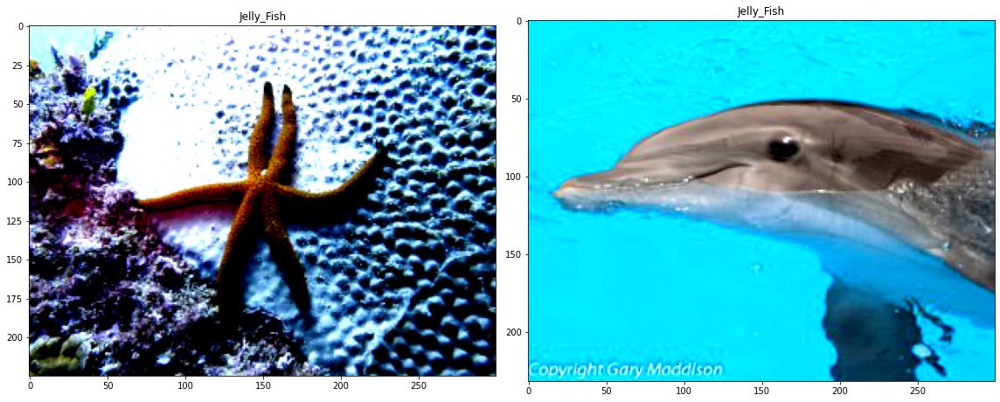

In [82]:
pluto.draw_image_contrast(pluto.df_sea_animal,contrast=8.5,bsize=2)

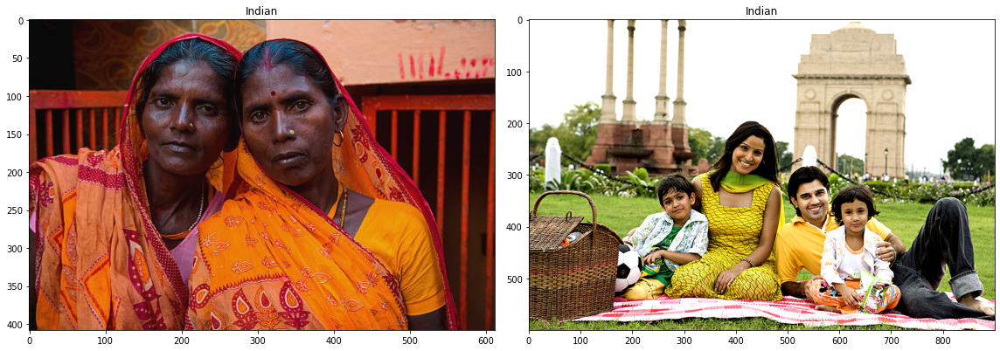

In [83]:
pluto.draw_image_contrast(pluto.df_people,contrast=0.3,bsize=2)

## saturation

In [84]:
@add_method(PacktDataAug)
def draw_image_saturation(self,df,saturation=0.2,bsize=5):
  aug_album = albumentations.ColorJitter(brightness=0.0,
    contrast=0.0, saturation=saturation,hue=0.0,always_apply=True, p=1.0)
  self._draw_image_album(df,aug_album,bsize)
  return

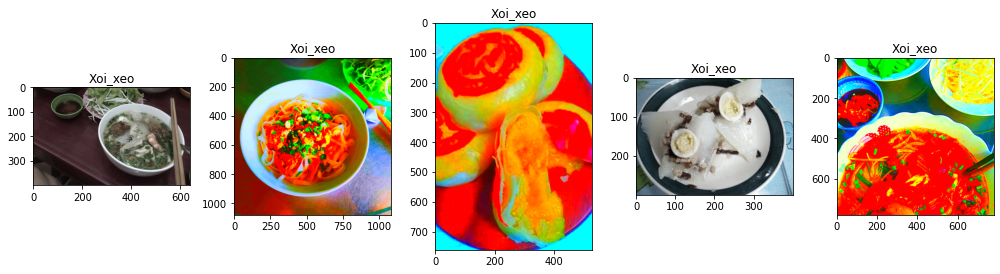

In [85]:
pluto.draw_image_saturation(pluto.df_food, saturation=10.5)

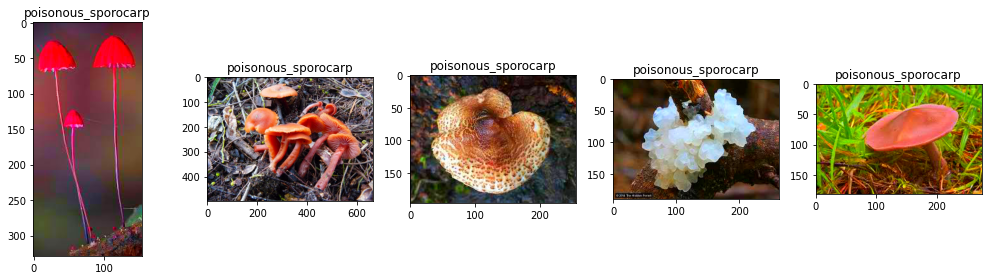

In [86]:
pluto.draw_image_saturation(pluto.df_fungi, saturation=2.5)

## Hue

In [87]:
@add_method(PacktDataAug)
def draw_image_hue(self,df,hue=0.2,bsize=5):
  aug_album = albumentations.ColorJitter(brightness=0.0,
    contrast=0.0, saturation=0.0,hue=hue,always_apply=True, p=1.0)
  self._draw_image_album(df,aug_album,bsize)
  return

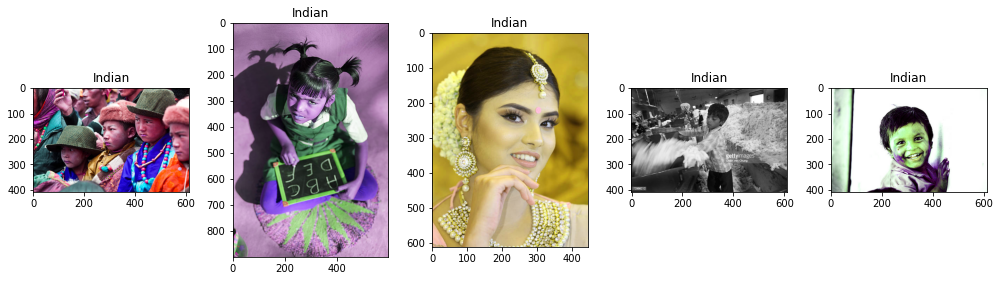

In [88]:
pluto.draw_image_hue(pluto.df_people,hue=0.5)

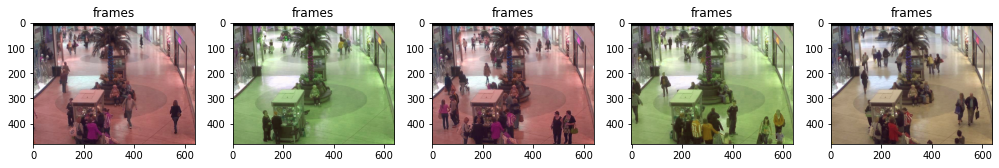

In [89]:
pluto.draw_image_hue(pluto.df_crowd,hue=0.2)

## Noise

In [90]:
@add_method(PacktDataAug)
def draw_image_noise(self,df,var_limit=(10.0, 50.0),bsize=5):
  aug_album = albumentations.GaussNoise(var_limit=var_limit,
    always_apply=True, p=1.0)
  self._draw_image_album(df,aug_album,bsize)
  return

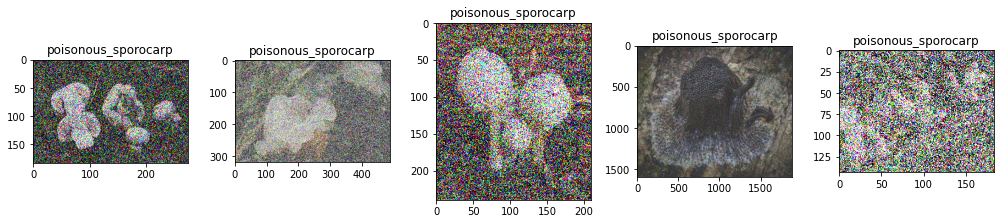

In [91]:
pluto.draw_image_noise(pluto.df_fungi,var_limit=(20000.0, 30000.0))

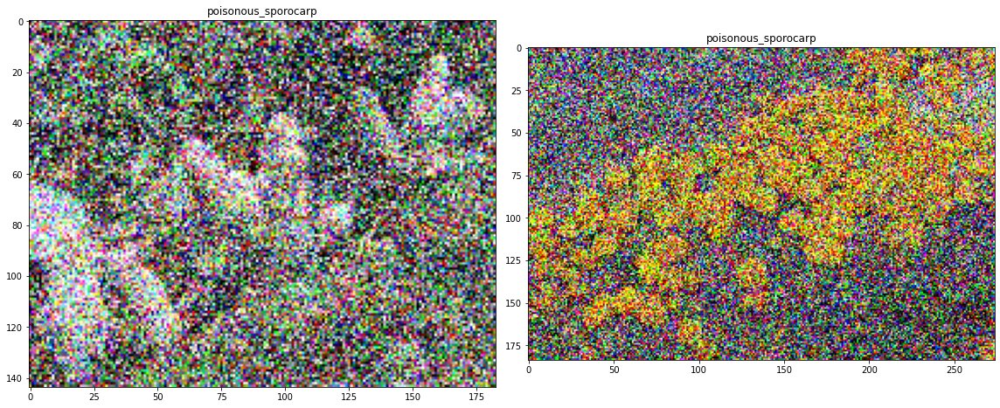

In [92]:
pluto.draw_image_noise(pluto.df_fungi,var_limit=(10000.0, 20000.0),bsize=2)

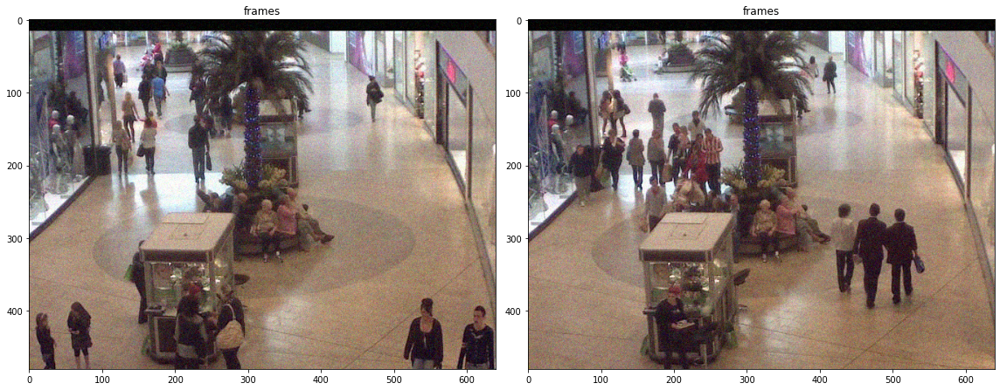

In [93]:
pluto.draw_image_noise(pluto.df_crowd,var_limit=(200.0, 400.0),bsize=2)

## Snow (not cover in the book)

In [94]:
@add_method(PacktDataAug)
def draw_image_snow(self,df,snow_point_lower=0.1,snow_point_upper=0.3,bsize=2,brightness_coeff=2.5):
  aug_album = albumentations.RandomSnow(snow_point_lower=snow_point_lower,
    snow_point_upper = snow_point_upper, always_apply=True, p=1.0,brightness_coeff=brightness_coeff)
  self._draw_image_album(df,aug_album,bsize)
  return

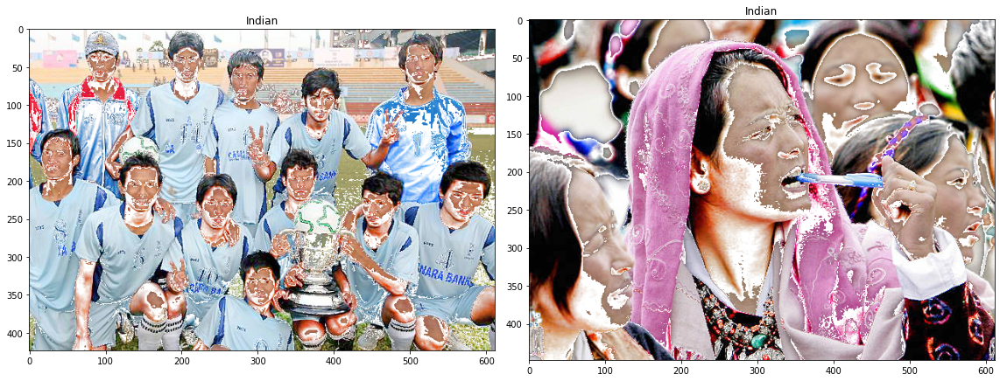

In [95]:
pluto.draw_image_snow(pluto.df_people)

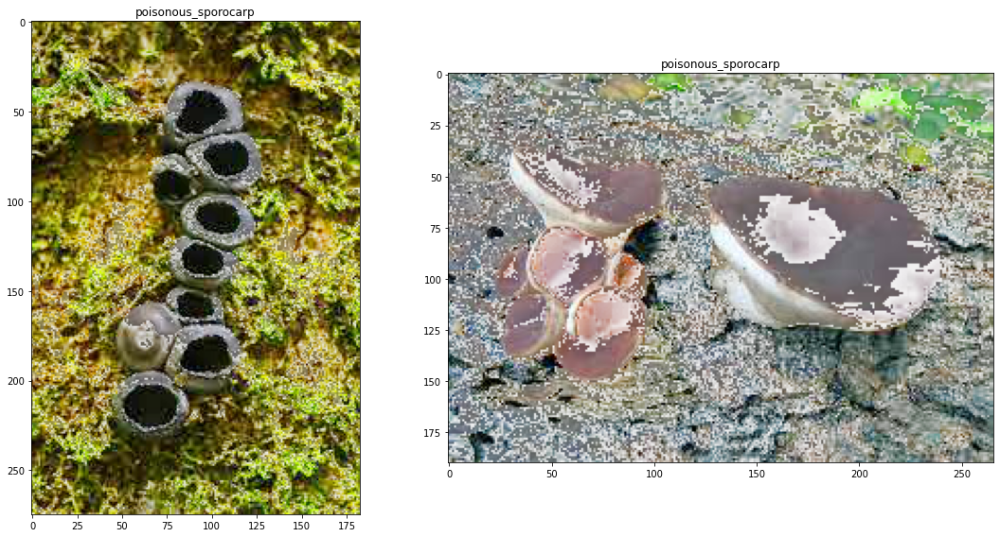

In [96]:
pluto.draw_image_snow(pluto.df_fungi,snow_point_lower=0.01, snow_point_upper=0.1)

## Sunflare

In [97]:
@add_method(PacktDataAug)
def draw_image_sunflare(self,df,flare_roi=(0, 0, 1, 0.5),src_radius=400,bsize=2):
  aug_album = albumentations.RandomSunFlare(flare_roi=flare_roi,
    src_radius=src_radius, always_apply=True, p=1.0)
  self._draw_image_album(df,aug_album,bsize)
  return

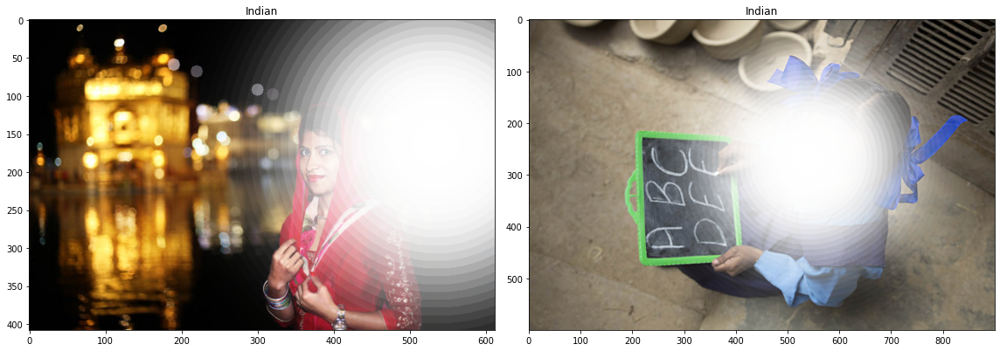

In [98]:
pluto.draw_image_sunflare(pluto.df_people, flare_roi=(0, 0, 1, 0.5),src_radius=400,bsize=2)

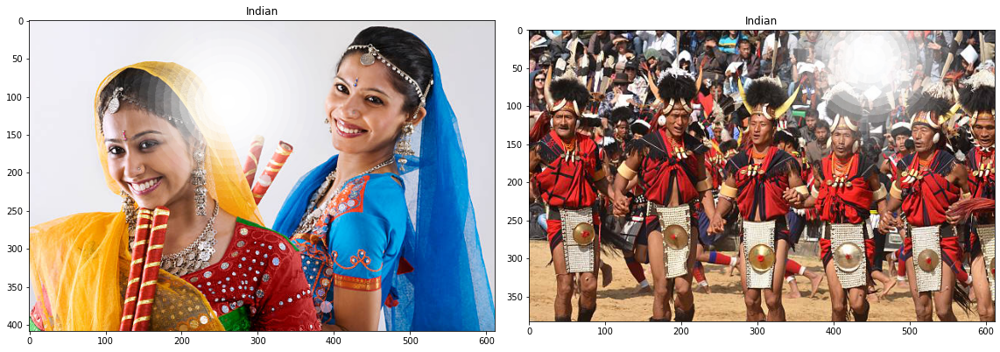

In [99]:
pluto.draw_image_sunflare(pluto.df_people, src_radius=200)

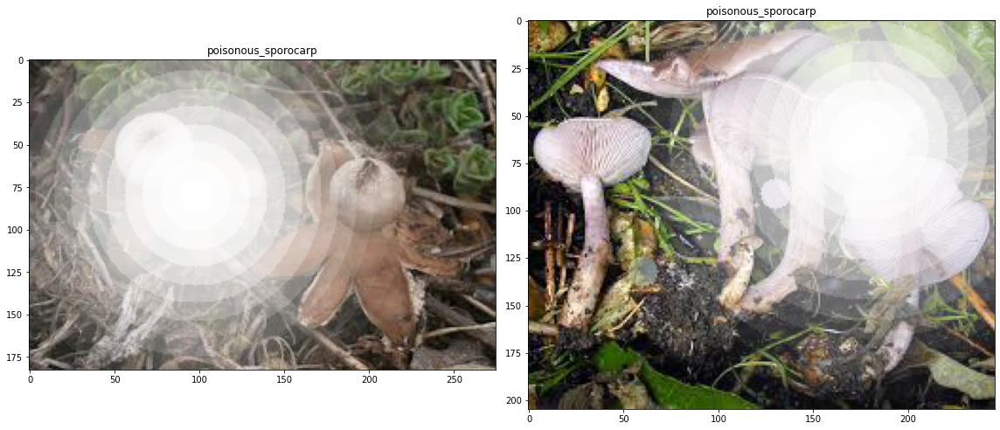

In [100]:
pluto.draw_image_sunflare(pluto.df_fungi, src_radius=200)

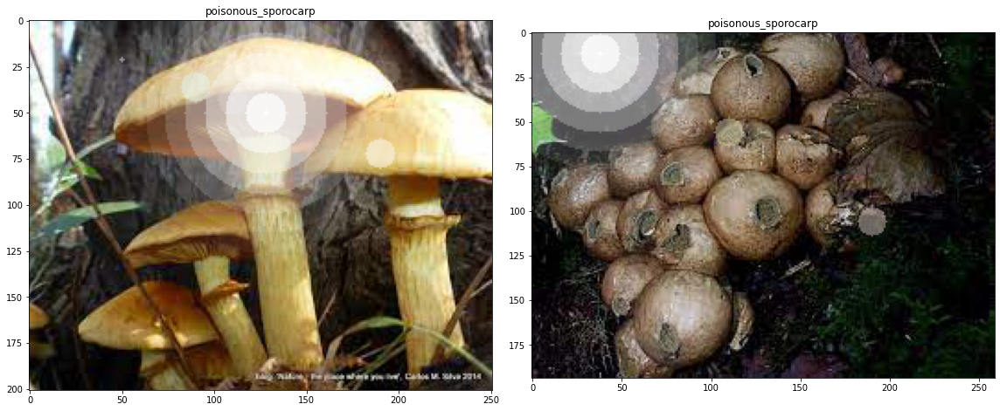

In [101]:
pluto.draw_image_sunflare(pluto.df_fungi, src_radius=120)

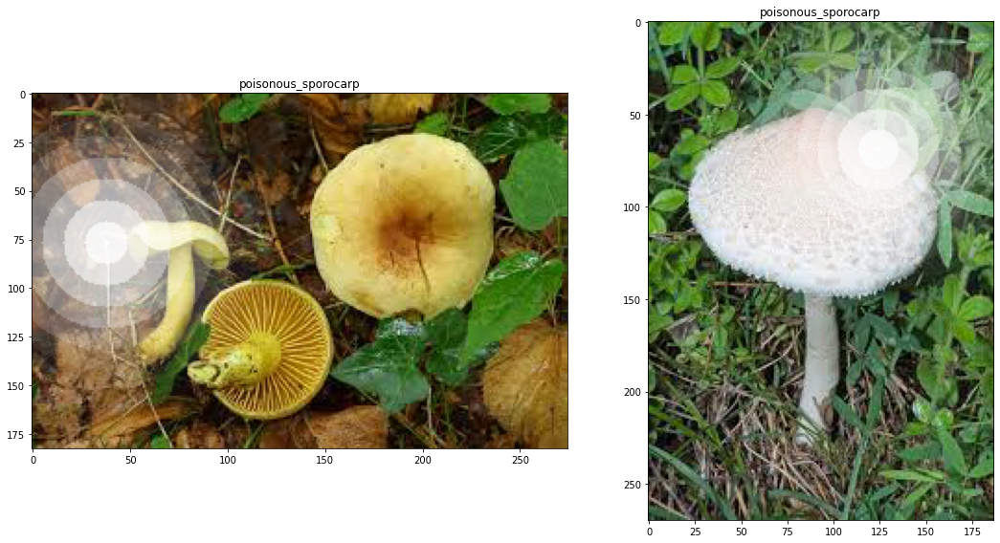

In [102]:
pluto.draw_image_sunflare(pluto.df_fungi, src_radius=120)

## Rain

In [103]:
@add_method(PacktDataAug)
def draw_image_rain(self,df,drop_length=20, drop_width=1,blur_value=1,bsize=2):
  aug_album = albumentations.RandomRain(drop_length=drop_length, drop_width=drop_width,
    blur_value=blur_value,always_apply=True, p=1.0)
  self._draw_image_album(df,aug_album,bsize)
  return

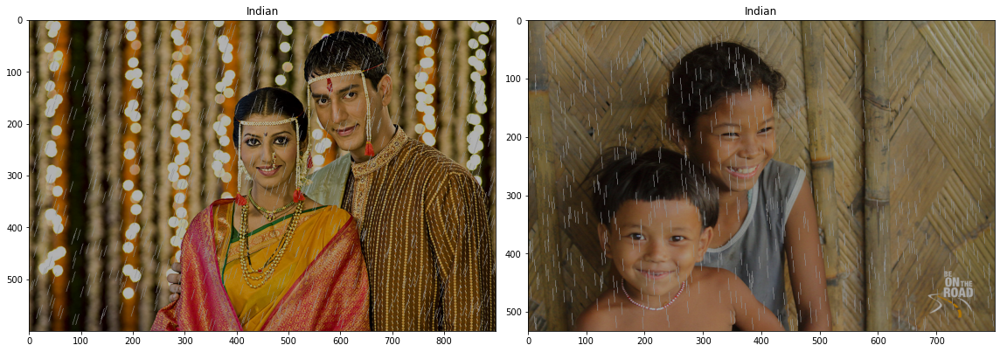

In [106]:
pluto.draw_image_rain(pluto.df_people, drop_length=20, drop_width=1,blur_value=1)

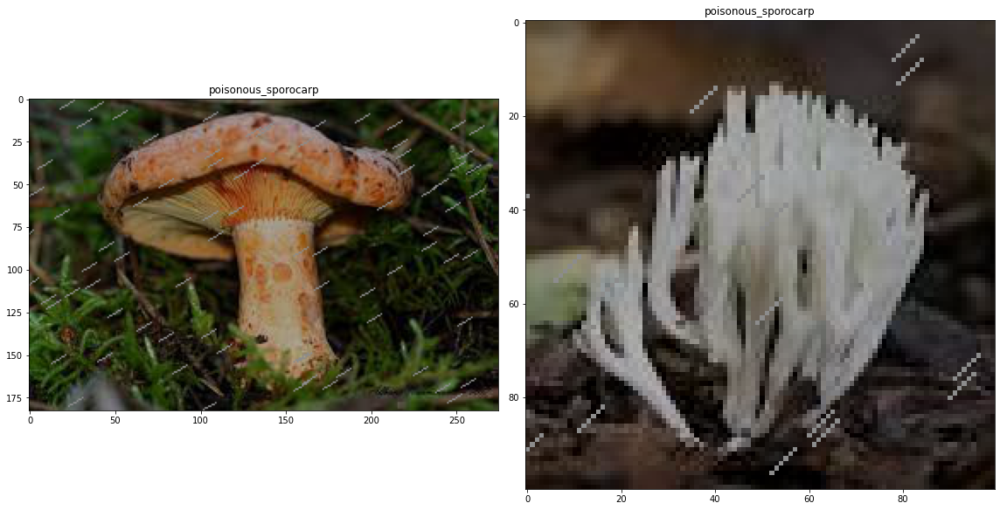

In [107]:
pluto.draw_image_rain(pluto.df_fungi,drop_length=5)

## Sepia

In [108]:
@add_method(PacktDataAug)
def draw_image_sepia(self,df,bsize=5):
  aug_album = albumentations.ToSepia(always_apply=True, p=1.0)
  self._draw_image_album(df,aug_album,bsize)
  return

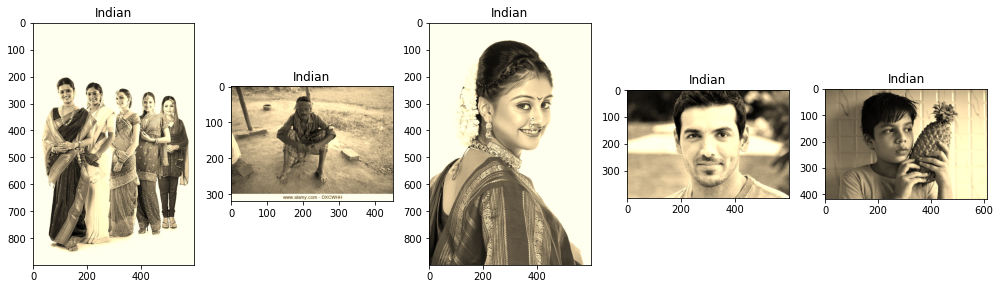

In [109]:
pluto.draw_image_sepia(pluto.df_people)

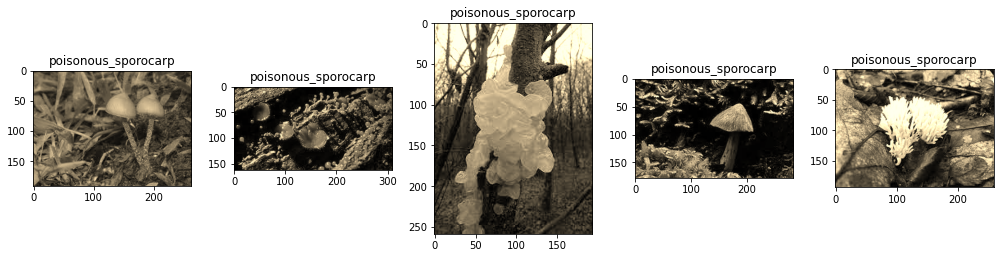

In [110]:
pluto.draw_image_sepia(pluto.df_fungi)

## FancyPCA

In [111]:
@add_method(PacktDataAug)
def draw_image_fancyPCA(self,df,alpha=0.1,bsize=5):
  aug_album = albumentations.FancyPCA(alpha=alpha, always_apply=True, p=1.0)
  self._draw_image_album(df,aug_album,bsize)
  return

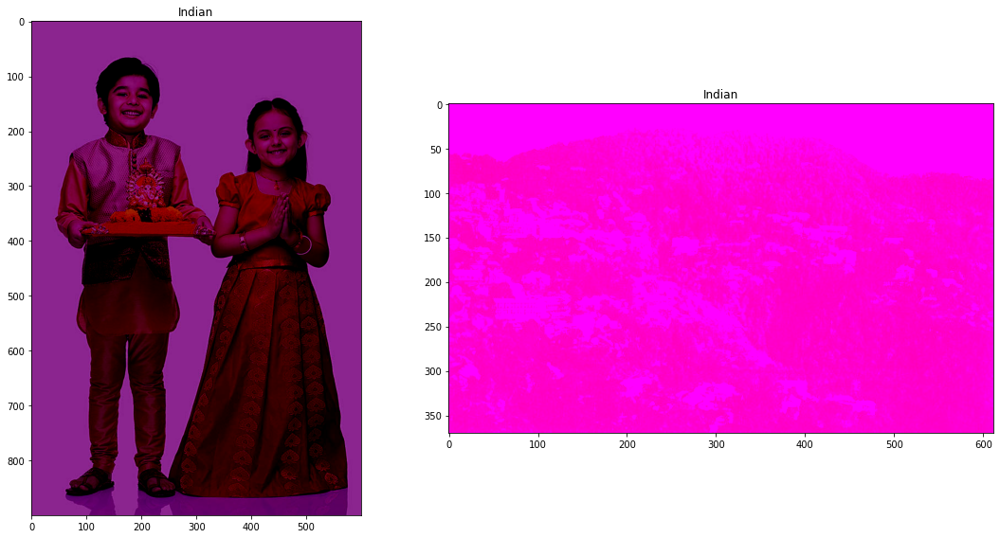

In [112]:
pluto.draw_image_fancyPCA(pluto.df_people,alpha=5.0,bsize=2)

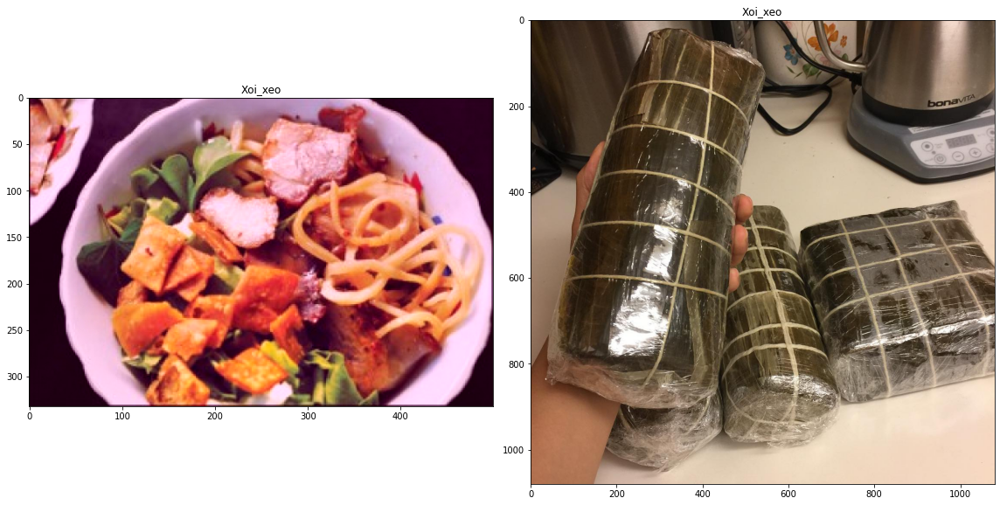

In [113]:
pluto.draw_image_fancyPCA(pluto.df_food,alpha=0.5,bsize=2)

# Random Erasing

In [114]:
@add_method(PacktDataAug)
def draw_image_erasing(self,df,bsize=8,max_count=5):
  aug = [fastai.vision.augment.RandomErasing(p=1.0,max_count=max_count)]
  itfms = fastai.vision.augment.Resize(480)
  dsl_org = self._make_data_loader(df, aug,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

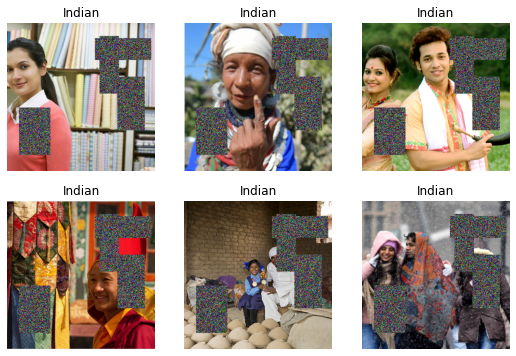

In [115]:
pluto.dls_people = pluto.draw_image_erasing(pluto.df_people,bsize=6, max_count=5)

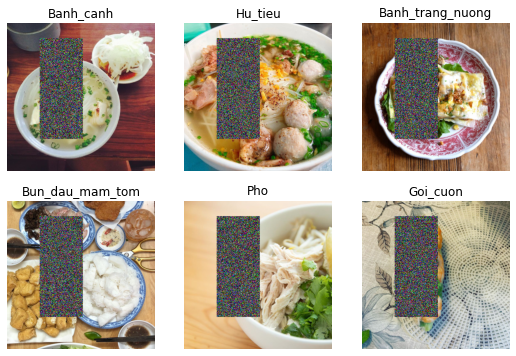

In [116]:
pluto.dls_food = pluto.draw_image_erasing(pluto.df_food,bsize=6,max_count=4)

# Combination

In [ ]:
#

## draw table

In [149]:
@add_method(PacktDataAug)
def print_safe_parameters(self):
  data = [['Horizontal Flip','NA','Yes','Yes','Yes','Yes','Yes',],
    ['Vertical Flip','NA','NA','NA','Yes','Yes','NA',],
    ['Croping and Padding','NA','pad=border','pad=border','pad=reflection','pad=reflection','pad=zeros',],
    ['Rotation','NA','max_rotate=25.0','max_rotate=25.0','max_rotate=180.0','max_rotate=180.0','max_rotate=16.0',],
    ['Warping','NA','magnitude=0.3','magnitude=0.3','magnitude=0.4','magnitude=0.4','magnitude=0.3',],
    ['Lighting','brightness=0.2','brightness=0.3','brightness=0.3','brightness=0.4','brightness=0.4','brightness=0.3',],
    ['Grayscale','NA','NA','NA','NA','NA','Yes',],
    ['Contrast','contrast=0.1','contrast=0.3','contrast=0.3','contrast=0.3','contrast=0.4','contrast=0.4',],
    ['Saturation','NA','saturation=3.5','saturation=2.0','saturation=3.0','saturation=3.0','saturation=2.5',],
    ['Hue Shifting','NA','NA','NA','hue=0.15','hue=0.2','hue=0.2',],
    ['Noise Injection','limit=(100.0, 300.0)','limit=(300.0, 500.0)','limit=(200.0, 400.0)','limit=(200.0, 400.0)','limit=(300.0, 400.0)','limit=(300.0, 500.0)',],
    ['Sun Flare','NA','NA','radius=200','NA','NA','NA',],
    ['Rain','NA','NA','length=20','NA','NA','NA',],
    ['Sepia','NA','Yes','NA','NA','NA','NA',],
    ['FancyPCA','NA','alpha=0.5','alpha=0.5','alpha=0.5','alpha=0.5','NA',],
    ['Random Erasing','NA','max_count=3','max_count=3','max_count=4','max_count=4','NA',]]
  # Create the pandas DataFrame
  df = pandas.DataFrame(data, columns=['Filter','Covid-19', 'People', 'Fungi', 'Sea Animal', 'Food', 'Mall Crowd'])
  display(df)
  return

In [152]:
pluto.print_safe_parameters()

,Filter,Covid-19,People,Fungi,Sea Animal,Food,Mall Crowd
0,Horizontal Flip,NA,Yes,Yes,Yes,Yes,Yes
1,Vertical Flip,NA,NA,NA,Yes,Yes,NA
2,Croping and Padding,NA,pad=border,pad=border,pad=reflection,pad=reflection,pad=zeros
3,Rotation,NA,max_rotate=25.0,max_rotate=25.0,max_rotate=180.0,max_rotate=180.0,max_rotate=16.0
4,Warping,NA,magnitude=0.3,magnitude=0.3,magnitude=0.4,magnitude=0.4,magnitude=0.3
5,Lighting,brightness=0.2,brightness=0.3,brightness=0.3,brightness=0.4,brightness=0.4,brightness=0.3
6,Grayscale,NA,NA,NA,NA,NA,Yes
7,Contrast,contrast=0.1,contrast=0.3,contrast=0.3,contrast=0.3,contrast=0.4,contrast=0.4
8,Saturation,NA,saturation=3.5,saturation=2.0,saturation=3.0,saturation=3.0,saturation=2.5
9,Hue Shifting,NA,NA,NA,hue=0.15,hue=0.2,hue=0.2


## draw augment covid-19

In [166]:
class AlbumentationsTransform(DisplayedTransform):
  split_idx,order=0,2
  def __init__(self, train_aug): store_attr()
  
  def encodes(self, img: fastai.vision.core.PILImage):
    aug_img = self.train_aug(image=numpy.array(img))['image']
    return fastai.vision.core.PILImage.create(aug_img)
#
def get_train_aug(): return albumentations.Compose([
  #albumentations.HueSaturationValue(
      #hue_shift_limit=0.2, 
      #sat_shift_limit=0.2, 
      #val_shift_limit=0.2, 
      #p=0.5
  #),
  albumentations.ColorJitter(brightness=0.2,
    contrast=0.0, saturation=0.0,hue=0.0,p=0.5)
])

In [170]:
@add_method(PacktDataAug)
def _fetch_album_covid19(self):
  return albumentations.Compose([
  albumentations.ColorJitter(brightness=0.2, contrast=0.0, saturation=0.0,hue=0.0,p=0.5)
  ])
#
@add_method(PacktDataAug)
def draw_augment_covid19(self,df,bsize=15):
  aug = [
    fastai.vision.augment.Brightness(max_lighting=0.3,p=0.5),
    fastai.vision.augment.Contrast(max_lighting=0.4, p=0.5),
    fastai.vision.augment.RandomErasing(p=0.3, sl=0.0, sh=0.2, min_aspect=0.3, max_count=1),
    fastai.vision.augment.Flip(p=0.5),
    fastai.vision.augment.Zoom(max_zoom=1,p=0.5),
    AlbumentationsTransform(self._fetch_album_covid19())
    ]
  itfms = fastai.vision.augment.Resize(480)
  dsl_org = self._make_data_loader(df, aug,itfms)
  dsl_org.show_batch(max_n=bsize)
  return dsl_org

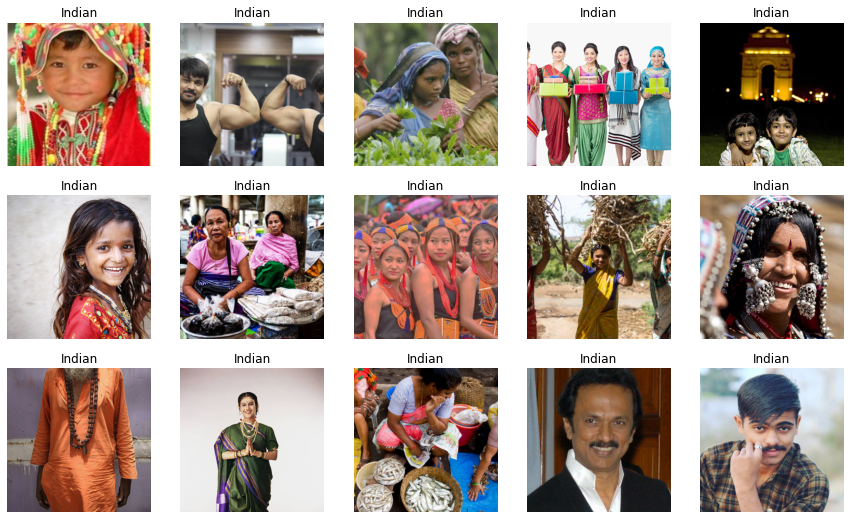

In [168]:
pluto.dls_covid19 = pluto.draw_augment_covid19(pluto.df_people)

# scratch section - fastbook (delete after complete)

In [ ]:
# print (pluto.__dict__)

In [ ]:
# import inspect
# x = inspect.getmembers(pluto, predicate=inspect.ismethod)
# df = pandas.DataFrame(x,columns=['function_name', 'def'])
# df.head()

In [ ]:
# import inspect
# y = inspect.getmembers(pluto)
# y

In [ ]:
# dir(pluto)

In [ ]:
!pip install -Uqq fastbook
import fastbook
fastbook.setup_book()
from fastbook import *

     |████████████████████████████████| 719 kB 31.7 MB/s 
     |████████████████████████████████| 4.9 MB 36.2 MB/s 
     |████████████████████████████████| 432 kB 56.6 MB/s 
     |████████████████████████████████| 1.3 MB 52.1 MB/s 
     |████████████████████████████████| 212 kB 72.0 MB/s 
     |████████████████████████████████| 115 kB 68.8 MB/s 
     |████████████████████████████████| 163 kB 76.6 MB/s 
     |████████████████████████████████| 127 kB 71.7 MB/s 
     |████████████████████████████████| 6.6 MB 59.3 MB/s 
Mounted at /content/gdrive


In [ ]:
PILImage

fastai.vision.core.PILImage

In [ ]:
load_image

<function fastai.vision.core.load_image(fn, mode=None)>

In [ ]:
import fastai
import fastai.vision

In [ ]:
img = fastai.vision.core.load_image(pluto.df_food.fname[0])
img.show()

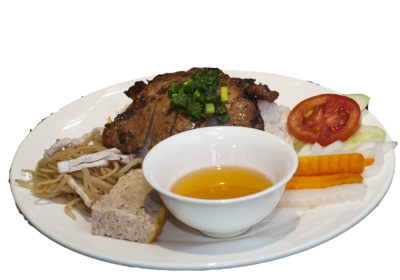

In [ ]:
display(img)

In [ ]:
type(img)

PIL.Image.Image

# Push up all changes (delete after complete)

- username: duchaba

- password: [use the token]

In [ ]:
f = '/content/Data-Augmentation-with-Python'
!git add -A
!git config --global user.email "duc.haba@gmail.com"
!git config --global user.name "duchaba"
!git commit -m "end of session, comment here"

In [ ]:
#use the xterm
#git push

# Summary 

Every chaper will begin with same base class "PacktDataAug".

✋ FAIR WARNING:

- The coding uses long and complete function path name.

- I wrote the code for easy to understand and not for compactness, fast execution, nor cleaverness.

- Use Xterm to debug cloud server



In [ ]:
!pip install colab-xterm
%load_ext colabxterm
%xterm